---

### Running Julia

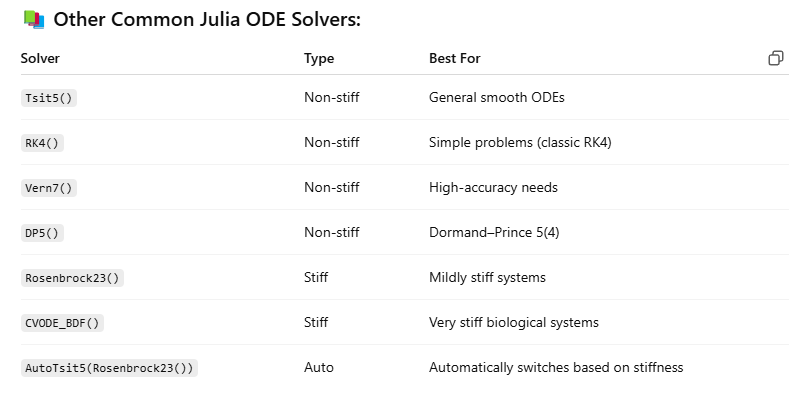

Libraries used in the official Tutorial of Vizuhara:

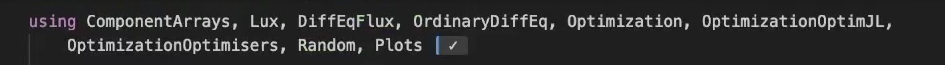

The Langmuir adsorption model is described by the following differential equation:

$$
\frac{dq}{dt} = k_a \cdot C \cdot (Q_m - q) - k_d \cdot q
$$

In [1]:
using DifferentialEquations

# Parameters for synthetic data
ka = 1.0f0
kd = 0.5f0
Qm = 2.0f0
C = 1.0f0

function langmuir_ode!(dq, q, p, t)
    dq[1] = ka * C * (Qm - q[1]) - kd * q[1]
end

q0 = Float32[0.0]
tspan = (0.0f0, 10.0f0)
datasize = 30
tsteps = range(tspan[1], tspan[2], length = datasize)

prob = ODEProblem(langmuir_ode!, q0, tspan)
sol = solve(prob, Tsit5(), saveat=tsteps)

retcode: Success
Interpolation: 1st order linear
t: 30-element Vector{Float32}:
  0.0
  0.3448276
  0.6896552
  1.0344827
  1.3793104
  1.7241379
  2.0689654
  2.413793
  2.7586207
  3.1034484
  ⋮
  7.2413793
  7.586207
  7.9310346
  8.275862
  8.620689
  8.965517
  9.310345
  9.655172
 10.0
u: 30-element Vector{Vector{Float32}}:
 [0.0]
 [0.5384497]
 [0.8594535]
 [1.0508262]
 [1.1649152]
 [1.2329261]
 [1.273473]
 [1.2976555]
 [1.3120551]
 [1.3206562]
 ⋮
 [1.3333086]
 [1.3333124]
 [1.3333215]
 [1.3333302]
 [1.3333338]
 [1.3333322]
 [1.3333282]
 [1.3333284]
 [1.3333305]

In [2]:
ode_data = Array(sol)

1×30 Matrix{Float32}:
 0.0  0.53845  0.859453  1.05083  …  1.33333  1.33333  1.33333  1.33333

In [3]:
length(ode_data)

30

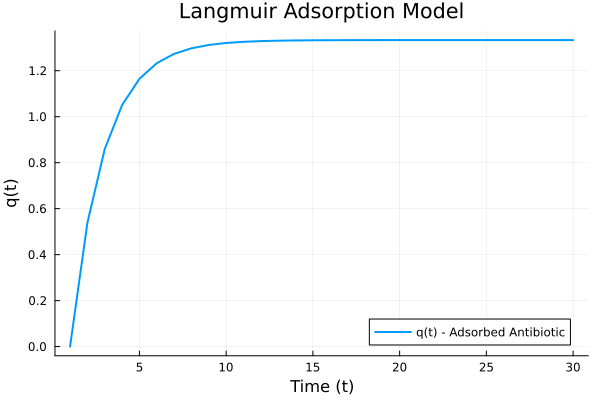

In [4]:
using Plots

plot(ode_data',
     label="q(t) - Adsorbed Antibiotic",
     xlabel="Time (t)",
     ylabel="q(t)",
     title="Langmuir Adsorption Model",
     lw=2,
     legend=:bottomright,
     grid=true)

In [5]:
sol(10)

1-element Vector{Float32}:
 1.3333305

### 🎯 Next Goal: Neural ODE
Train a **Neural ODE** that learns to approximate the behavior of the Langmuir model — based only on the synthetic data we just generated.

In [6]:
using DifferentialEquations, DiffEqFlux, Flux, Plots, Random

In [7]:
# Set up RNG
rng = Random.default_rng()

# Time span and save points
tspan = (0.0f0, 10.0f0)
datasize = 30
tsteps = range(tspan[1], tspan[2], length = datasize)


lux_model = Lux.Chain(
    Lux.Dense(1, 16, tanh),
    Lux.Dense(16, 1)
)

# Initialize parameters and state
ps, st = Lux.setup(rng, lux_model)

# Define ODE function
lux_ode_function = (u, p, t) -> lux_model(u, ps, st)[1] # returns only the model output

#11 (generic function with 1 method)

In [8]:
print("Weights: ", ps.layer_1.weight, "\nBiases:  ", ps.layer_1.bias, "\n")

Weights: Float32[-1.9359976; -2.5084083; -1.5615648; 0.0016053551; -0.58108485; -2.2988343; 2.303746; 0.09506696; -2.2270703; -2.1447644; -0.843245; -2.6492667; 1.8617221; -0.2957859; -1.0507638; -0.23115255;;]
Biases:  Float32[-0.3010702, 0.48309064, 0.76213896, -0.8859687, 0.62835956, -0.12006998, -0.08456528, -0.9181849, -0.35739422, 0.5300759, -0.7014185, 0.26221168, 0.35503483, 0.34560812, 0.20856488, 0.5468973]


In [9]:
# Create Neural ODE using the Lux model
neural_ode = NeuralODE(lux_model, tspan, Tsit5(), saveat=tsteps)

NeuralODE(
    model = Chain(
        layer_1 = Dense(1 => 16, tanh),  # 32 parameters
        layer_2 = Dense(16 => 1),       # 17 parameters
    ),
)         # Total: 49 parameters,
          #        plus 0 states.

In [10]:
# Initial condition
y0 = Float32[0.0] # same as q0

# Evaluate the Neural ODE - forward pass  ➜ returns (solution, new_state)
predicted, _ = neural_ode(y0, ps, st)

(ODESolution{Float32, 2, Vector{Vector{Float32}}, Nothing, Nothing, Vector{Float32}, Vector{Vector{Vector{Float32}}}, Nothing, ODEProblem{Vector{Float32}, Tuple{Float32, Float32}, false, @NamedTuple{layer_1::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}, layer_2::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}}, ODEFunction{false, SciMLBase.FullSpecialize, DiffEqFlux.var"#dudt#17"{StatefulLuxLayer{Static.True, Lux.Chain{@NamedTuple{layer_1::Lux.Dense{typeof(tanh), Int64, Int64, Nothing, Nothing, Static.True}, layer_2::Lux.Dense{typeof(identity), Int64, Int64, Nothing, Nothing, Static.True}}, Nothing}, Nothing, @NamedTuple{layer_1::@NamedTuple{}, layer_2::@NamedTuple{}}}}, LinearAlgebra.UniformScaling{Bool}, Nothing, typeof(DiffEqFlux.basic_tgrad), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing, Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, @NamedTuple{}}, SciMLBase

In [11]:
print(predicted)

ODESolution{Float32, 2, Vector{Vector{Float32}}, Nothing, Nothing, Vector{Float32}, Vector{Vector{Vector{Float32}}}, Nothing, ODEProblem{Vector{Float32}, Tuple{Float32, Float32}, false, @NamedTuple{layer_1::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}, layer_2::@NamedTuple{weight::Matrix{Float32}, bias::Vector{Float32}}}, ODEFunction{false, SciMLBase.FullSpecialize, DiffEqFlux.var"#dudt#17"{StatefulLuxLayer{Static.True, Lux.Chain{@NamedTuple{layer_1::Lux.Dense{typeof(tanh), Int64, Int64, Nothing, Nothing, Static.True}, layer_2::Lux.Dense{typeof(identity), Int64, Int64, Nothing, Nothing, Static.True}}, Nothing}, Nothing, @NamedTuple{layer_1::@NamedTuple{}, layer_2::@NamedTuple{}}}}, LinearAlgebra.UniformScaling{Bool}, Nothing, typeof(DiffEqFlux.basic_tgrad), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing, Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, @NamedTuple{}}, SciMLBase.

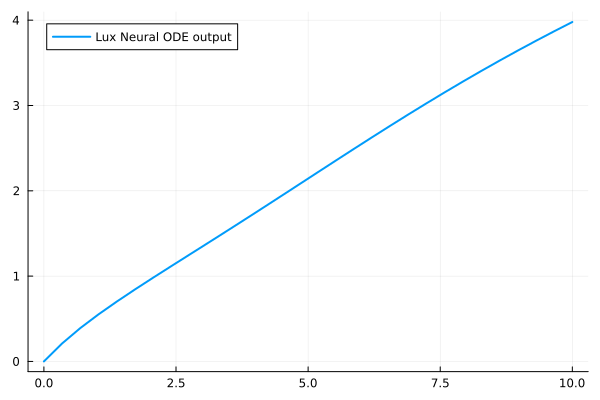

In [12]:
# Plot results
output = hcat(predicted.u...) |> x -> convert(Matrix{Float32}, x)
plot(tsteps, output', label="Lux Neural ODE output", lw=2)

In [13]:
# Prediction Function

function predict_neuralode(ps)
    Array(neural_ode(y0, ps, st)[1])
end

predict_neuralode (generic function with 1 method)

In [14]:
predict_neuralode(ps)

1×30 Matrix{Float32}:
 0.0  0.210856  0.39138  0.55221  …  3.64295  3.75778  3.8697  3.97874

### 🎯 Next Goal: Creating a training loop based on the loss

In [15]:
using ComponentArrays, Optimization, OptimizationOptimisers, Optim, OptimizationOptimJL

In [16]:
# Calculate Loss: the difference between actual function and the loss function.
function loss_neuralode(p)
    pred = predict_neuralode(p)
    loss = sum(abs2, ode_data .- pred)
    return loss, pred
end

loss_neuralode (generic function with 1 method)

In [17]:
loss_neuralode(ps)

(55.366158f0, Float32[0.0 0.21085641 … 3.8697038 3.978743])

In [18]:
callback = function (state, l; doplot = true)
    println("loss = ", l)

    if doplot
        pvec = state.u                     # current parameters (ComponentVector)
        pred = predict_neuralode(pvec)     # forward pass
        plt  = scatter(tsteps, ode_data[1, :]; label = "data")
        scatter!(plt, tsteps, pred[1, :]; label = "prediction")
        display(plt)
    end
    return false                           # return `true` to stop early
end

#15 (generic function with 1 method)

In [19]:
psinit = ComponentArray(ps)
callback(loss_neuralode(psinit)...; doplot = false)

loss = Float32[0.0 0.21085641 0.39138037 0.5522098 0.70166886 0.8442074 0.9824801 1.1183707 1.2532712 1.3881558 1.5236496 1.6600626 1.7974309 1.9356047 2.0743191 2.2131982 2.3518083 2.4897015 2.6264484 2.7616653 2.8950093 3.0261881 3.1549525 3.2811205 3.404567 3.5251975 3.6429467 3.7577832 3.8697038 3.978743]


false

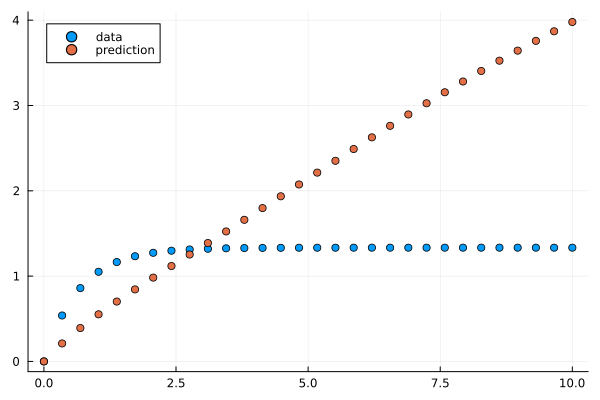

loss = 55.366165
loss = 27.318018
loss = 34.577347
loss = 36.258526
loss = 36.345215
loss = 35.755257
loss = 34.815945
loss = 33.670628
loss = 32.390835
loss = 31.015863
loss = 29.568731
loss = 28.064407
loss = 26.5131
loss = 24.922565
loss = 23.299545
loss = 21.649963
loss = 19.980019
loss = 18.296003
loss = 16.604773
loss = 14.914597
loss = 13.234914
loss = 11.576297
loss = 9.951803
loss = 8.376915
loss = 6.869571
loss = 5.4510956
loss = 4.1461062
loss = 2.9824975
loss = 1.9910867
loss = 1.2036779
loss = 0.6500053
loss = 0.35183644
loss = 0.3142663
loss = 0.51418656
loss = 0.890446
loss = 1.3445405
loss = 1.7592812
loss = 2.0349438
loss = 2.11949
loss = 2.0180566
loss = 1.778566
loss = 1.4653894
loss = 1.1414522
loss = 0.8526788
loss = 0.6257399
loss = 0.4697725
loss = 0.38137773
loss = 0.34957337
loss = 0.36005715
loss = 0.39811122
loss = 0.45047674
loss = 0.5061459
loss = 0.55682343
loss = 0.59683233
loss = 0.62289983
loss = 0.63367236
loss = 0.62972397
loss = 0.61254805
loss = 0.5

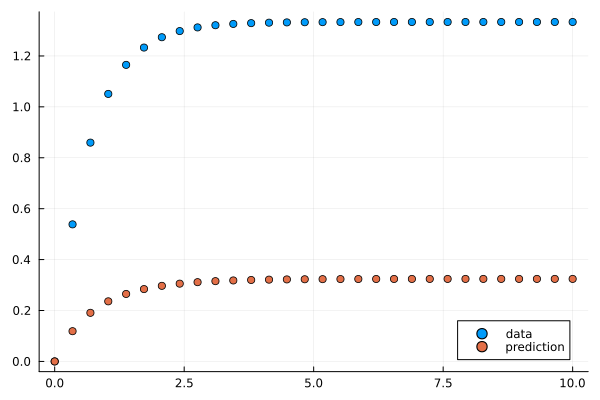

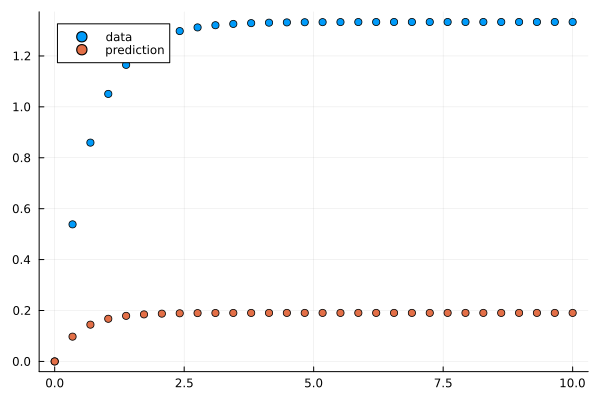

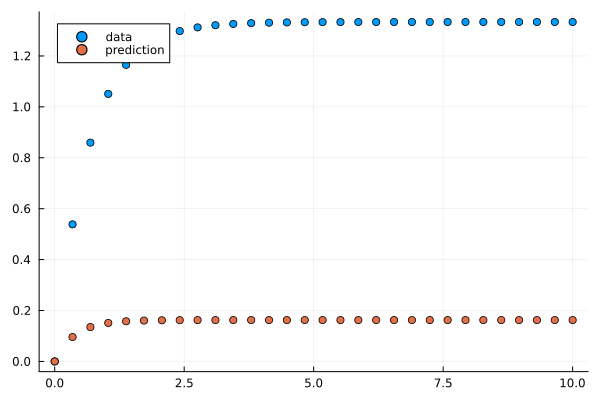

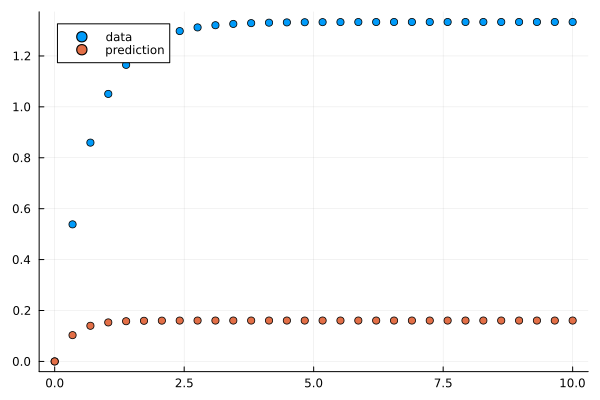

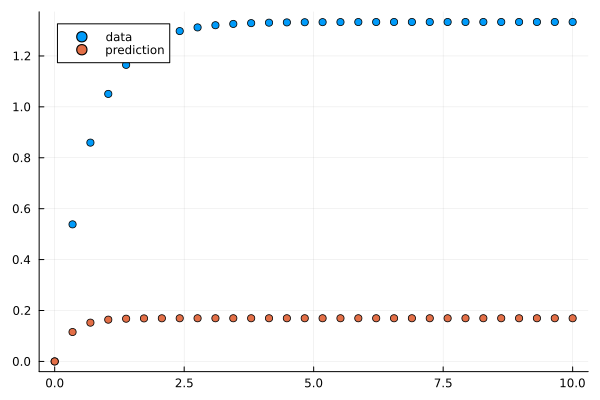

...

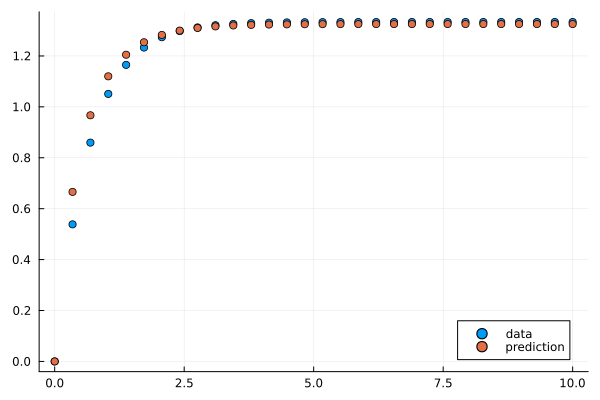

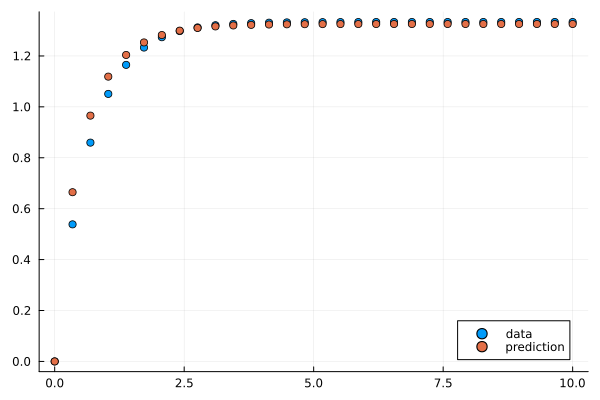

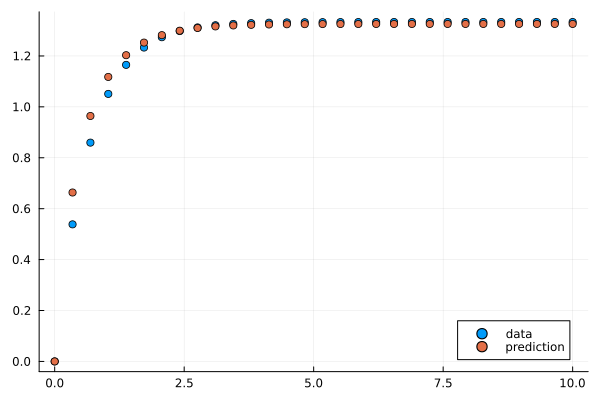

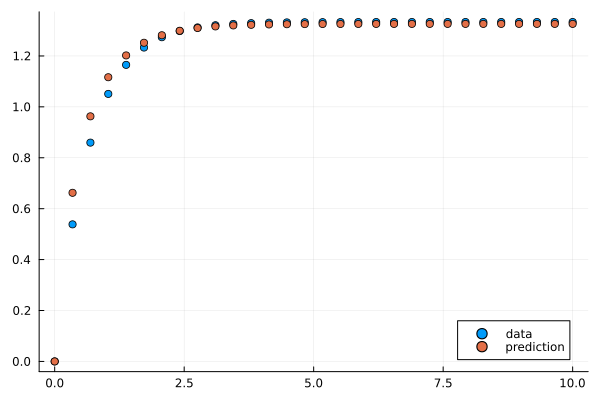

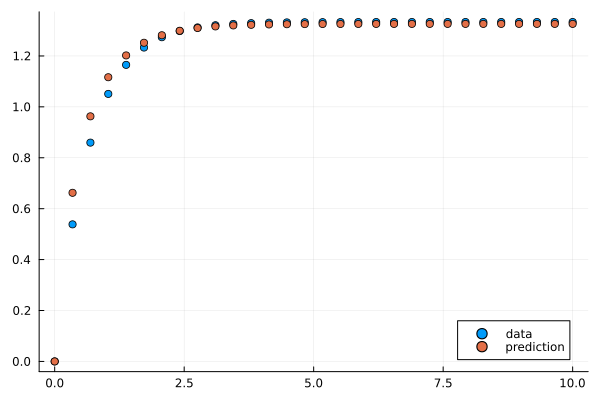

retcode: Default
u: ComponentVector{Float32}(layer_1 = (weight = Float32[-2.0837657; -0.5401722; … ; -0.21505325; -0.48077554;;], bias = Float32[-0.6615496, 2.115867, 1.6366638, -0.74476945, 0.8576678, -0.39813536, -0.9696748, -0.733971, 0.22192565, 1.8692017, -0.10471787, 1.0548234, 0.75997186, 0.5346328, 1.106329, 0.40732136]), layer_2 = (weight = Float32[-0.13611186 0.2879581 … 0.20361626 0.31515703], bias = Float32[-0.05037004]))

In [20]:
# Use Optimization.jl to solve the problem
adtype = Optimization.AutoZygote()

optf = Optimization.OptimizationFunction((x, p) -> loss_neuralode(x)[1], adtype)
optprob = Optimization.OptimizationProblem(optf, psinit)

result_neuralode = Optimization.solve(optprob, OptimizationOptimisers.Adam(0.05); callback = callback, maxiters = 300)

In [21]:
println("ADAM final loss = ", result_neuralode.objective)

ADAM final loss = 0.03321795


### ✨ Success!! 
Initial Loss: **407.35355** -> Final loss: **0.0025218525**


### 🎯Let us Finetune! using "BFGS"

Why a second optimiser?

Stage 1: **ADAM** – fast, noisy, good for escaping bad basins.

Stage 2: **BFGS** – deterministic quasi-Newton; once you’re close to
a minimum it can converge with fewer steps and higher precision.

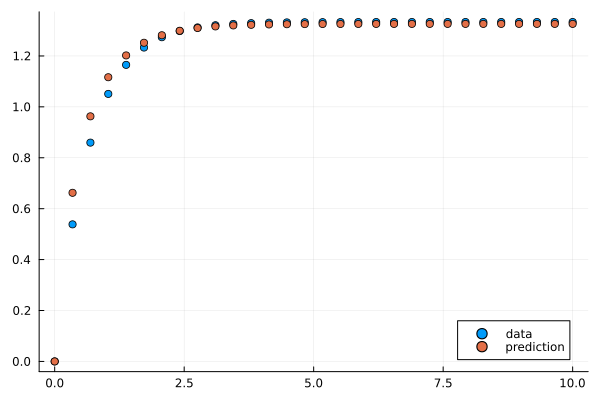

loss = 0.03321798
loss = 0.030317198
loss = 0.01071044
loss = 0.0042657354
loss = 0.0042093243
loss = 0.0024777367
loss = 0.0017531926
loss = 0.0008118951
loss = 0.00035754556
loss = 6.97778e-5
loss = 3.518229e-5
loss = 1.1030131e-5
loss = 7.443508e-6
loss = 7.407124e-6
loss = 7.39228e-6
loss = 7.3921838e-6
loss = 7.0248475e-6
loss = 5.546671e-6
loss = 7.944433e-7
loss = 2.0396354e-7
loss = 4.7544e-8
loss = 1.8799856e-8
loss = 1.7753539e-8
loss = 1.7663499e-8
loss = 1.6582597e-8
loss = 1.6042026e-8
loss = 1.5978404e-8
loss = 1.5744469e-8
loss = 1.5744469e-8


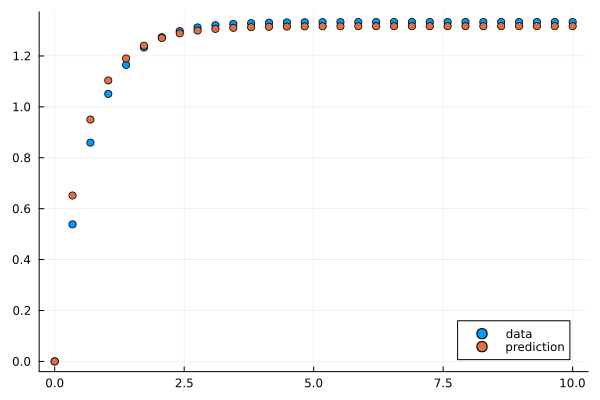

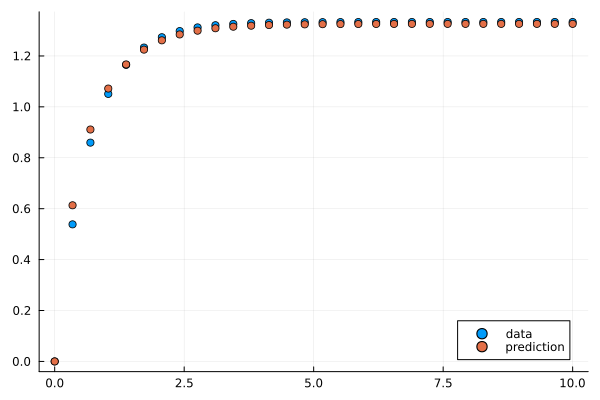

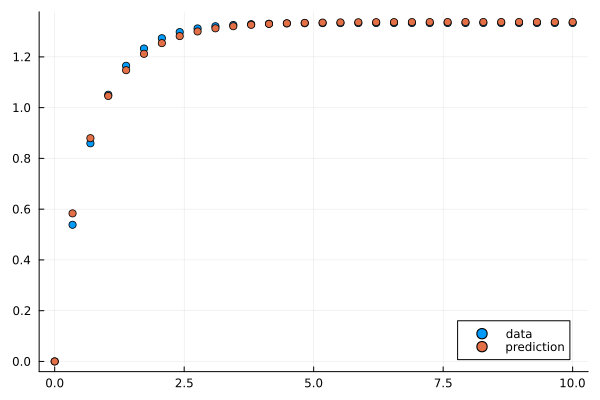

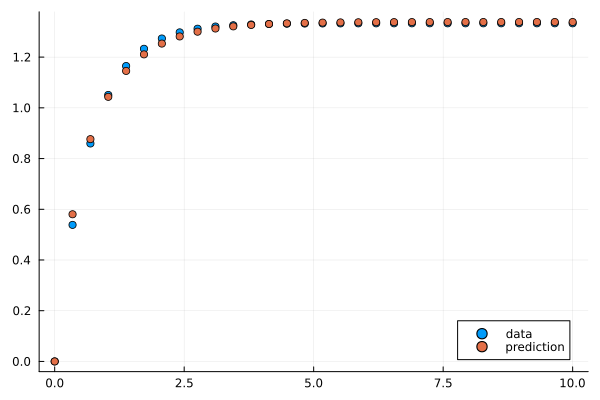

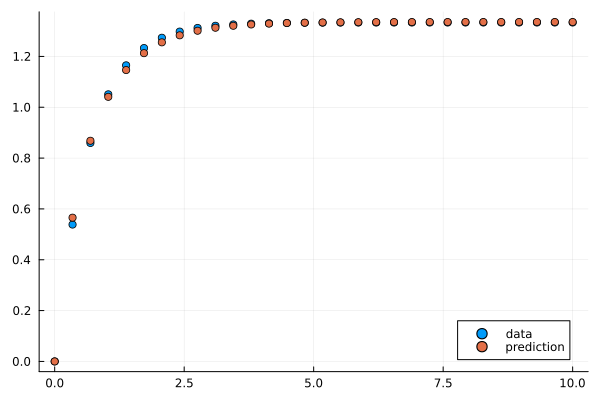

...

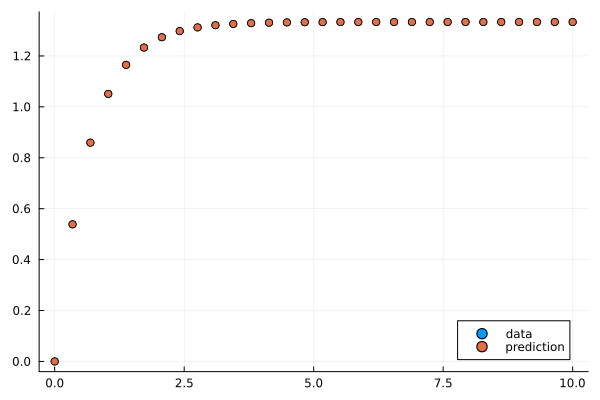

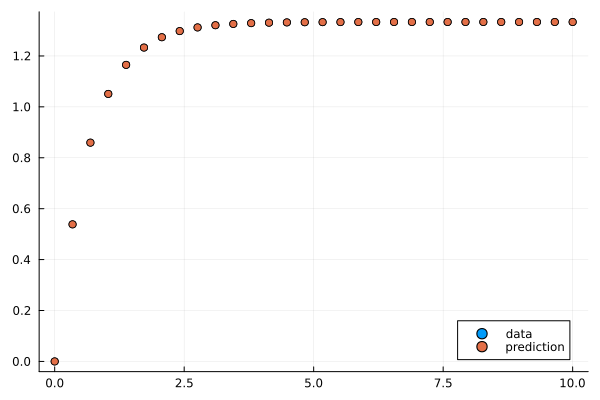

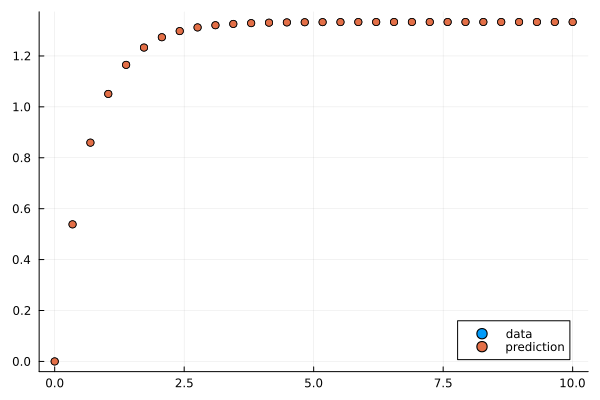

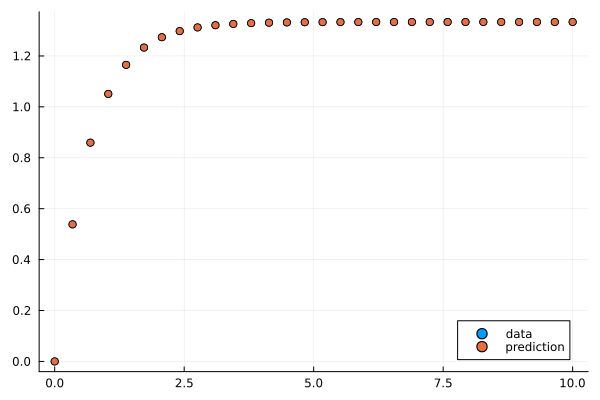

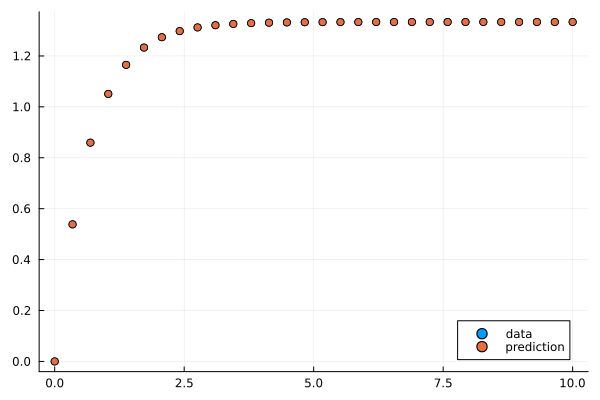

retcode: Success
u: ComponentVector{Float32}(layer_1 = (weight = Float32[-2.0807984; -0.5766305; … ; -0.24388762; -0.48286617;;], bias = Float32[-0.65190643, 2.1009173, 1.6131058, -0.7315126, 0.83689886, -0.39527968, -1.0619152, -0.72684884, 0.08565636, 1.8537071, -0.11104972, 1.0385028, 0.74697566, 0.52420336, 1.0936466, 0.40895963]), layer_2 = (weight = Float32[-0.08171246 0.2289991 … 0.15068409 0.34152296], bias = Float32[-0.14181402]))

In [22]:
optprob2 = remake(optprob; u0 = result_neuralode.u)
result_neuralode2 = Optimization.solve(optprob2, OptimizationOptimJL.BFGS(; initial_stepnorm = 0.01); callback, allow_f_increases = false)

In [23]:
final_p = result_neuralode2.u

ComponentVector{Float32}(layer_1 = (weight = Float32[-2.0807984; -0.5766305; … ; -0.24388762; -0.48286617;;], bias = Float32[-0.65190643, 2.1009173, 1.6131058, -0.7315126, 0.83689886, -0.39527968, -1.0619152, -0.72684884, 0.08565636, 1.8537071, -0.11104972, 1.0385028, 0.74697566, 0.52420336, 1.0936466, 0.40895963]), layer_2 = (weight = Float32[-0.08171246 0.2289991 … 0.15068409 0.34152296], bias = Float32[-0.14181402]))

In [24]:
final_loss, final_pred = loss_neuralode(final_p)

callback(final_p, final_loss; doplot = true)

loss = 1.5744469e-8


ErrorException: type NamedTuple has no field u

### 5% noise robustness experiment

In [28]:
using CSV, DataFrames, Plots, StatsPlots

csv_path = "langmuir_noisy_dataset.csv"
df = CSV.read(csv_path, DataFrame)

@assert size(df, 2) == 12 "CSV should have 12 columns (t, q_true, q_noisy_seed0…9)"

tsteps    = Float32.(df.t)
q_true    = Float32.(df.q_true)
noise_syms = names(df, r"q_noisy")              # Symbol[:q_noisy_seed0 … :q_noisy_seed9]
println("Loaded $(length(noise_syms)) noisy replicates (σ = 5 % of Qₘ).")

Loaded 10 noisy replicates (σ = 5 % of Qₘ).


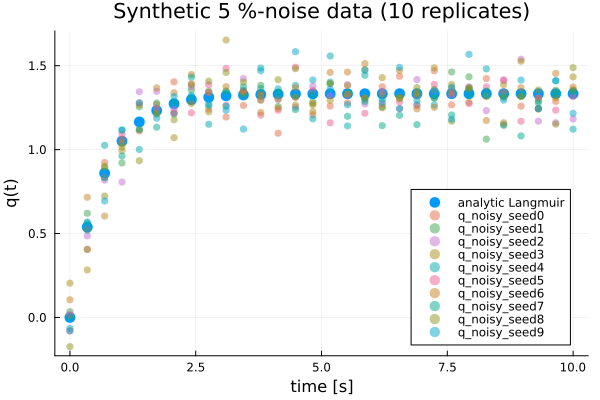

In [29]:
default(markerstrokecolor = :auto)

scatter(tsteps, q_true; label = "analytic Langmuir", ms = 6)
for sym in noise_syms
    scatter!(tsteps, Float32.(df[!, sym]); label = string(sym), ms = 4, alpha = 0.5)
end
xlabel!("time [s]"); ylabel!("q(t)")
title!("Synthetic 5 %-noise data (10 replicates)")

In [37]:
using DifferentialEquations, DiffEqFlux, Lux
using ComponentArrays, Optimization, OptimizationOptimisers, Optim
using Random, Statistics

# rely on tspan and tsteps already defined in earlier cells
MAXIT_ADAM = 300          # tweak if needed; _not_ const → no re-declare error
MAXIT_BFGS = 300

function fit_neural_ode(target_q::Vector{Float32};
                        rng_seed::Int = 0,
                        return_history::Bool = false)

    rng = Random.MersenneTwister(rng_seed)

    # network
    lux_model = Lux.Chain(
        Lux.Dense(1, 16, tanh),
        Lux.Dense(16, 1)
    )
    ps, st = Lux.setup(rng, lux_model)

    neural_ode = NeuralODE(lux_model, tspan, Tsit5(); saveat = tsteps)

    y0 = Float32[0]
    predict(p) = Array(neural_ode(y0, p, st)[1])

    loss_history = Float32[]
    function loss(p)
        pred = predict(p)
        l = sum(abs2, target_q .- pred)
        return_history && push!(loss_history, l)
        (l, pred)
    end

    optf   = Optimization.OptimizationFunction((x, p)->loss(x)[1],
                                               Optimization.AutoZygote())
    optprob = Optimization.OptimizationProblem(optf, ComponentArray(ps))

    # ── Adam stage ──
    res1 = Optimization.solve(optprob,
                              OptimizationOptimisers.Adam(0.05);
                              maxiters = MAXIT_ADAM,
                              rng      = rng)

    # ── BFGS stage ──  (remake problem instead of x0 kwarg)
    optprob2 = remake(optprob; u0 = res1.u)
    res2 = Optimization.solve(optprob2,
                              Optim.BFGS();
                              maxiters = MAXIT_BFGS)

    final_pred = predict(res2.u)
    rmse = sqrt(mean((target_q .- final_pred).^2))

    return return_history ? (rmse, loss_history, final_pred) : rmse
end

fit_neural_ode (generic function with 1 method)

seed 0: RMSE = 0.3604
seed 1: RMSE = 0.3567
seed 2: RMSE = 0.3763
seed 3: RMSE = 0.3753
seed 4: RMSE = 0.3745
seed 5: RMSE = 0.38
seed 6: RMSE = 0.3664
seed 7: RMSE = 0.3548
seed 8: RMSE = 0.4095
seed 9: RMSE = 0.3918

5 %-noise summary:  RMSE = 0.3746 ± 0.0168 (n = 10)


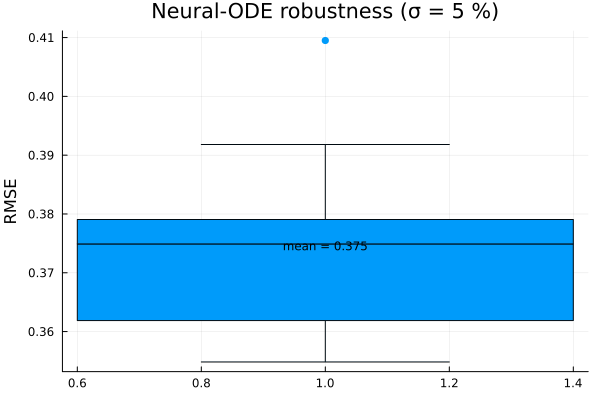

In [38]:
rmses = Float32[]

for (seed, sym) in enumerate(noise_syms)
    q_noisy = Float32.(df[!, sym])
    rmse = fit_neural_ode(q_noisy; rng_seed = seed)
    println("seed $(seed-1): RMSE = $(round(rmse, digits=4))")
    push!(rmses, rmse)
end

mean_rmse = mean(rmses)
std_rmse  = std(rmses)

println("\n5 %-noise summary:  RMSE = $(round(mean_rmse, digits=4)) ± $(round(std_rmse, digits=4)) (n = 10)")

boxplot(rmses; label = "", ylabel = "RMSE", title = "Neural-ODE robustness (σ = 5 %)")
annotate!(1, mean_rmse, text("mean = $(round(mean_rmse,digits=3))", :center, 8))

In [40]:
q_noisy0 = Float32.(df[!, :q_noisy_seed0])
rmse0, loss_hist0, pred0 = fit_neural_ode(q_noisy0;
                                          rng_seed = 0,
                                          return_history = true)

plt1 = plot(loss_hist0; yscale = :log10,
            xlabel = "ADAM/BFGS iteration",
            ylabel = "MSE",
            title  = "Training loss history (seed 0)")

plt2 = scatter(tsteps, q_noisy0; label = "noisy data (seed 0)")
plot!(plt2, tsteps, q_true; label = "analytic", lw = 2)
plot!(plt2, tsteps, pred0;  label = "Neural-ODE fit", lw = 2, ls = :dash)
xlabel!(plt2, "time [s]"); ylabel!(plt2, "q(t)")
title!(plt2, "Fit quality: RMSE(seed 0) = $(round(rmse0, digits=4))")

plot(plt1, plt2; layout = (1,2), size = (900,350))

ErrorException: Mutating arrays is not supported -- called push!(Vector{Float32}, ...)
This error occurs when you ask Zygote to differentiate operations that change
the elements of arrays in place (e.g. setting values with x .= ...)

Possible fixes:
- avoid mutating operations (preferred)
- or read the documentation and solutions for this error
  https://fluxml.ai/Zygote.jl/latest/limitations


#### noise-level sensitivity

In short, generate new datasets at 1 %, 5 %, 10 % noise, fit the same fit_neural_ode you already have, print mean ± SD RMSE for each level, and show a bar chart with error bars.

In [44]:
# ╔═╡ B1_generate_levels
using Random, Statistics

σ_levels   = [0.01f0, 0.05f0, 0.10f0]   # 1 %, 5 %, 10 %
replicates = 5                          # fits per noise level
Qm_val     = 2f0                        # same Qₘ as before

function make_noisy_curves(σ, n)
    [q_true .+ σ .* randn(Float32, length(q_true)) for _ in 1:n]
end

level_curves = Dict(σ => make_noisy_curves(σ*Qm_val, replicates) for σ in σ_levels)
println("Generated noisy datasets at 1 %, 5 %, 10 % of Qₘ.")

Generated noisy datasets at 1 %, 5 %, 10 % of Qₘ.


In [45]:
# ╔═╡ B2_fit_levels
level_stats = Dict{Float32,Tuple{Float32,Float32}}()   # σ => (mean, std)

for (j, σ) in enumerate(σ_levels)
    rmses = [fit_neural_ode(curve; rng_seed = 100*j + k)  # reuse your function
             for (k, curve) in enumerate(level_curves[σ])]
    μ, σdev = mean(rmses), std(rmses)
    level_stats[σ] = (μ, σdev)
    println("σ = $(Int(σ*100)) %  →  RMSE = $(round(μ, digits=4)) ± $(round(σdev, digits=4))")
end

σ = 1 %  →  RMSE = 0.3626 ± 0.0033
σ = 5 %  →  RMSE = 0.3647 ± 0.0114
σ = 10 %  →  RMSE = 0.4053 ± 0.0156


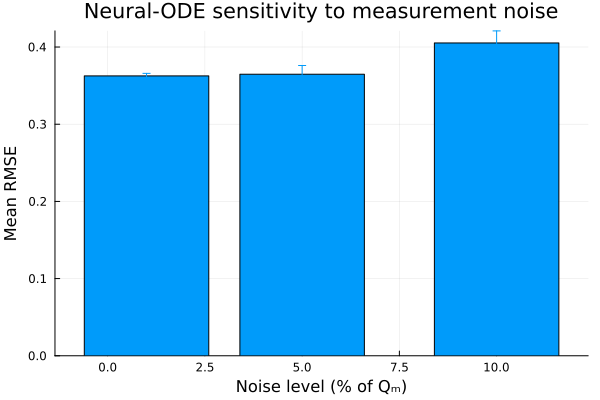

In [46]:
# ╔═╡ B3_plot_levels
using Plots

x  = Int.(σ_levels .* 100)                   # [1, 5, 10]
μs = [level_stats[σ][1] for σ in σ_levels]
σs = [level_stats[σ][2] for σ in σ_levels]

bar(x, μs; yerror = σs, legend = false,
    xlabel = "Noise level (% of Qₘ)",
    ylabel = "Mean RMSE",
    title  = "Neural-ODE sensitivity to measurement noise")